# K-Means Clustering


Let's work through an example of unsupervised learning - clustering customer data.

## Goal:

When working with unsupervised learning methods, its usually important to lay out a general goal. In our case, let's attempt to find reasonable clusters of customers for marketing segmentation and study. What we end up doing with those clusters would depend **heavily** on the domain itself, in this case, marketing.

----

## The Data

LINK: https://archive.ics.uci.edu/ml/datasets/bank+marketing

   This dataset is public available for research. The details are described in [Moro et al., 2011]. 


      [Moro et al., 2011] S. Moro, R. Laureano and P. Cortez. Using Data Mining for Bank Direct Marketing: An Application of the CRISP-DM Methodology. 
      In P. Novais et al. (Eds.), Proceedings of the European Simulation and Modelling Conference - ESM'2011, pp. 117-121, Guimarães, Portugal, October, 2011. EUROSIS.

      Available at: [pdf] http://hdl.handle.net/1822/14838
                    [bib] http://www3.dsi.uminho.pt/pcortez/bib/2011-esm-1.txt
     For more information, read [Moro et al., 2011].

    # bank client data:
    1 - age (numeric)
    2 - job : type of job (categorical: 'admin.','blue-collar','entrepreneur','housemaid','management','retired','self-employed','services','student','technician','unemployed','unknown')
    3 - marital : marital status (categorical: 'divorced','married','single','unknown'; note: 'divorced' means divorced or widowed)
    4 - education (categorical: 'basic.4y','basic.6y','basic.9y','high.school','illiterate','professional.course','university.degree','unknown')
    5 - default: has credit in default? (categorical: 'no','yes','unknown')
    6 - housing: has housing loan? (categorical: 'no','yes','unknown')
    7 - loan: has personal loan? (categorical: 'no','yes','unknown')
    # related with the last contact of the current campaign:
    8 - contact: contact communication type (categorical: 'cellular','telephone')
    9 - month: last contact month of year (categorical: 'jan', 'feb', 'mar', ..., 'nov', 'dec')
    10 - day_of_week: last contact day of the week (categorical: 'mon','tue','wed','thu','fri')
    11 - duration: last contact duration, in seconds (numeric). Important note: this attribute highly affects the output target (e.g., if duration=0 then y='no'). Yet, the duration is not known before a call is performed. Also, after the end of the call y is obviously known. Thus, this input should only be included for benchmark purposes and should be discarded if the intention is to have a realistic predictive model.
    # other attributes:
    12 - campaign: number of contacts performed during this campaign and for this client (numeric, includes last contact)
    13 - pdays: number of days that passed by after the client was last contacted from a previous campaign (numeric; 999 means client was not previously contacted)
    14 - previous: number of contacts performed before this campaign and for this client (numeric)
    15 - poutcome: outcome of the previous marketing campaign (categorical: 'failure','nonexistent','success')
    # social and economic context attributes
    16 - emp.var.rate: employment variation rate - quarterly indicator (numeric)
    17 - cons.price.idx: consumer price index - monthly indicator (numeric)
    18 - cons.conf.idx: consumer confidence index - monthly indicator (numeric)
    19 - euribor3m: euribor 3 month rate - daily indicator (numeric)
    20 - nr.employed: number of employees - quarterly indicator (numeric)
    21 - y - has the client subscribed a term deposit? (binary: 'yes','no')

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scienceplots

In [2]:
df = pd.read_csv(r'C:\Users\ibrahim\0010 Revisi ML di Github\data\bank-additional-full.csv', sep=';')

In [3]:
df.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


## Exploratory Data Anlysis

In [4]:
df.shape

(41188, 21)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41188 entries, 0 to 41187
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             41188 non-null  int64  
 1   job             41188 non-null  object 
 2   marital         41188 non-null  object 
 3   education       41188 non-null  object 
 4   default         41188 non-null  object 
 5   housing         41188 non-null  object 
 6   loan            41188 non-null  object 
 7   contact         41188 non-null  object 
 8   month           41188 non-null  object 
 9   day_of_week     41188 non-null  object 
 10  duration        41188 non-null  int64  
 11  campaign        41188 non-null  int64  
 12  pdays           41188 non-null  int64  
 13  previous        41188 non-null  int64  
 14  poutcome        41188 non-null  object 
 15  emp.var.rate    41188 non-null  float64
 16  cons.price.idx  41188 non-null  float64
 17  cons.conf.idx   41188 non-null 

In [6]:
# null value
df.isnull().sum()

age               0
job               0
marital           0
education         0
default           0
housing           0
loan              0
contact           0
month             0
day_of_week       0
duration          0
campaign          0
pdays             0
previous          0
poutcome          0
emp.var.rate      0
cons.price.idx    0
cons.conf.idx     0
euribor3m         0
nr.employed       0
y                 0
dtype: int64

In [7]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
age,41188.0,40.024060,10.421250,17.000,32.000,38.000,47.000,98.000
duration,41188.0,258.285010,259.279249,0.000,102.000,180.000,319.000,4918.000
campaign,41188.0,2.567593,2.770014,1.000,1.000,2.000,3.000,56.000
pdays,41188.0,962.475454,186.910907,0.000,999.000,999.000,999.000,999.000
previous,41188.0,0.172963,0.494901,0.000,0.000,0.000,0.000,7.000
emp.var.rate,41188.0,0.081886,1.570960,-3.400,-1.800,1.100,1.400,1.400
cons.price.idx,41188.0,93.575664,0.578840,92.201,93.075,93.749,93.994,94.767
cons.conf.idx,41188.0,-40.502600,4.628198,-50.800,-42.700,-41.800,-36.400,-26.900
euribor3m,41188.0,3.621291,1.734447,0.634,1.344,4.857,4.961,5.045
nr.employed,41188.0,5167.035911,72.251528,4963.600,5099.100,5191.000,5228.100,5228.100


## Countinuous Feature Analysis

In [8]:
df.columns

Index(['age', 'job', 'marital', 'education', 'default', 'housing', 'loan',
       'contact', 'month', 'day_of_week', 'duration', 'campaign', 'pdays',
       'previous', 'poutcome', 'emp.var.rate', 'cons.price.idx',
       'cons.conf.idx', 'euribor3m', 'nr.employed', 'y'],
      dtype='object')

In [9]:
categorical_df = df.select_dtypes(include='object')
numeric_df = df.select_dtypes(exclude='object')

In [10]:
numeric_df.columns

Index(['age', 'duration', 'campaign', 'pdays', 'previous', 'emp.var.rate',
       'cons.price.idx', 'cons.conf.idx', 'euribor3m', 'nr.employed'],
      dtype='object')

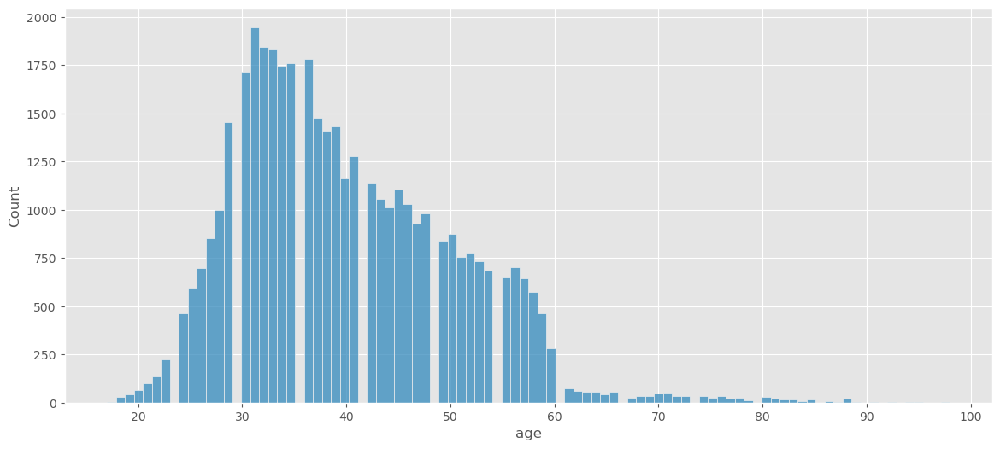

In [11]:
plt.style.use('ggplot')
plt.figure(figsize=(14,6))
sns.histplot(x='age', data=df);

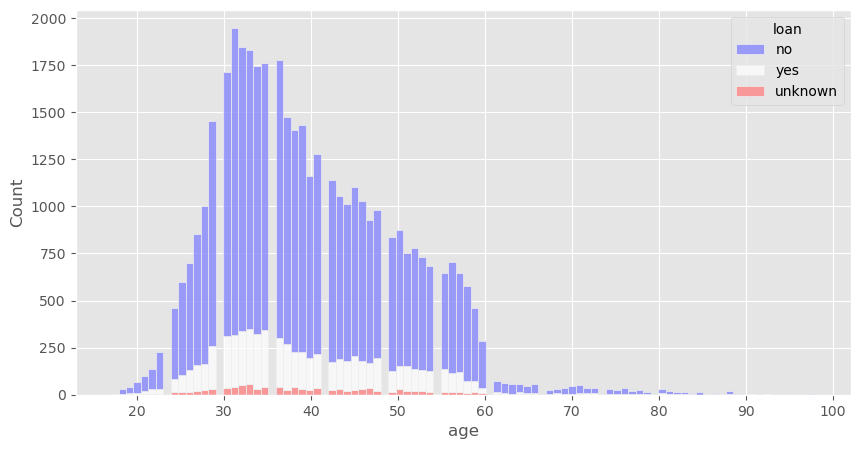

In [12]:
plt.figure(figsize=(10,5), dpi=100)
sns.histplot(x='age', hue='loan', palette= 'bwr',multiple='stack', data=df);

In [ ]:
1. Jika kita menawarkan pinjaman, kita mungkin tidak menargetkan orang-orang yang sudah memiliki pinjaman karena mereka mungkin tidak akan mengambil pinjaman lagi.
2. atau jika kita menarkan kepda orang yang sudah mempunyai pinjaman mungkin mereka tidak mau lagi karena sudah 

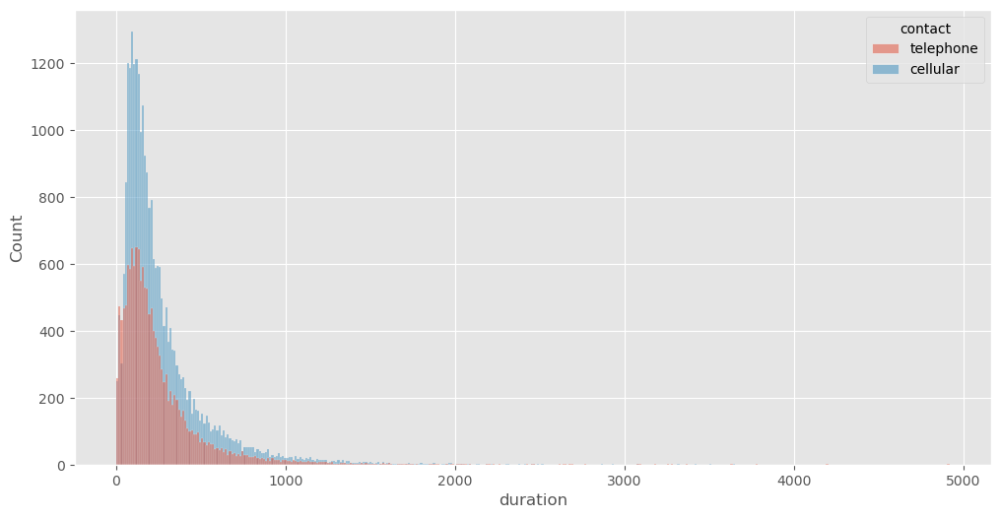

In [13]:
plt.figure(figsize=(12, 6))
sns.histplot(x='duration', hue='contact', data=df);

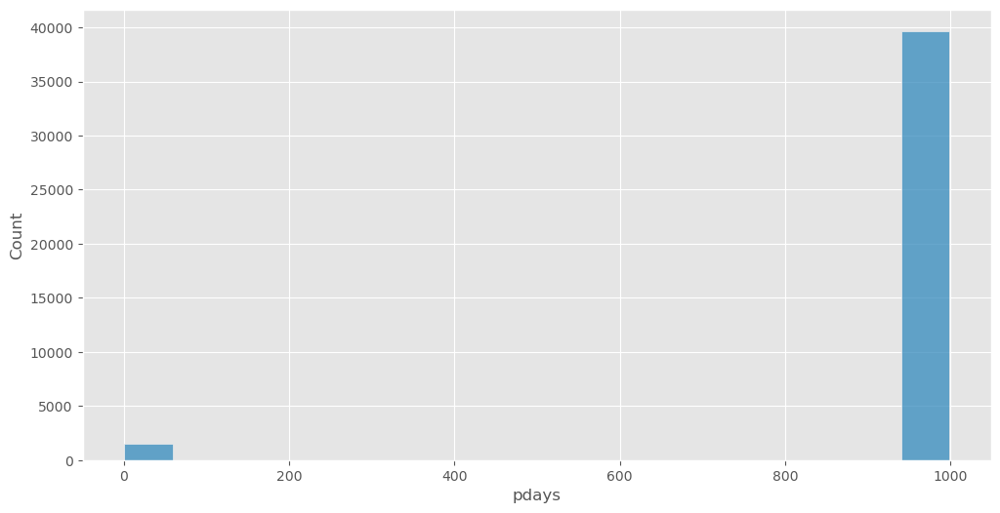

In [14]:
plt.figure(figsize=(12, 6))
sns.histplot(x='pdays', data=df);

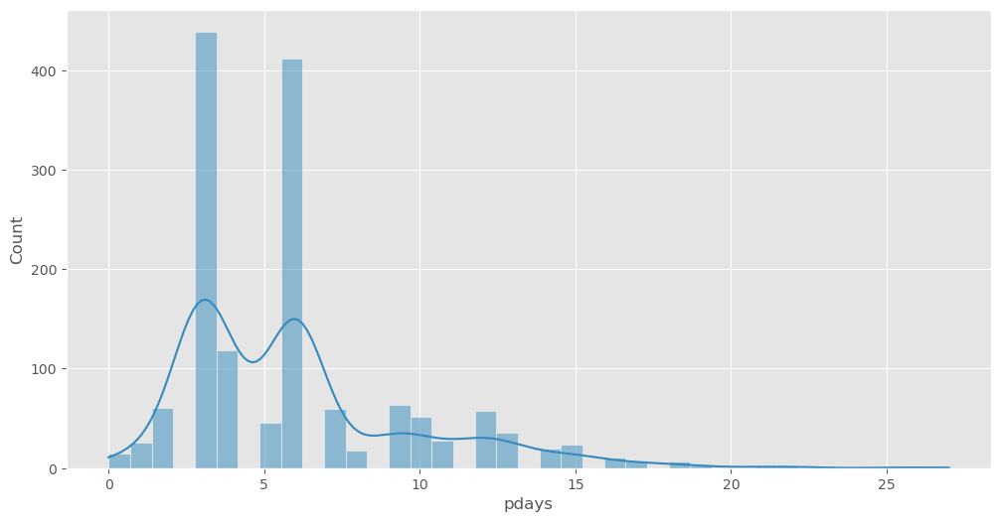

In [15]:
plt.figure(figsize=(12, 6))
pdays_df = df[df['pdays']!= 999]
sns.histplot(x='pdays', data=pdays_df, kde=True);

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


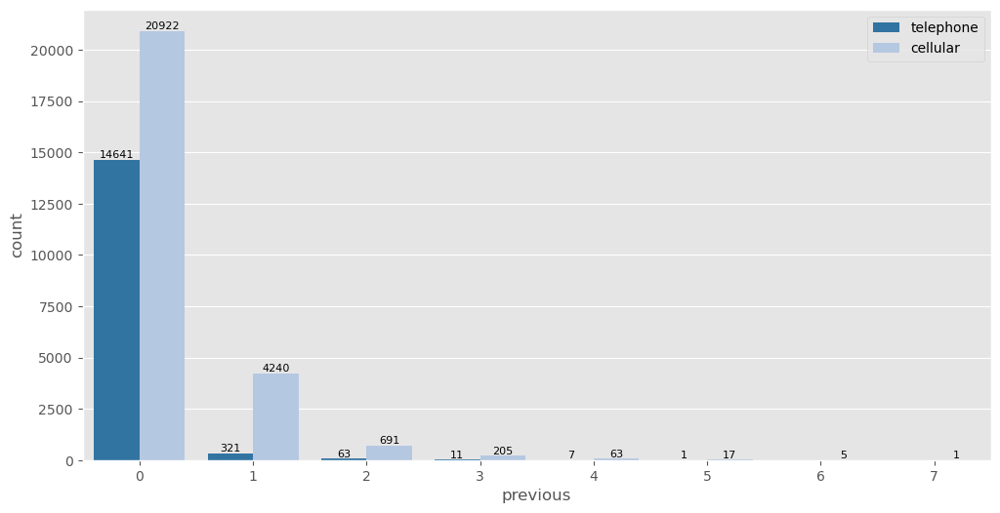

In [16]:
plt.figure(figsize=(12,6))
ax = sns.countplot(x='previous', hue='contact', order = df['previous'].value_counts().index ,data=df, palette='tab20')
for p in ax.patches:
    height = p.get_height()
    ax.text(x = p.get_x() + p.get_width()/2, 
            y = height + 100, 
            s = '{:.0f}'.format(height),
            ha = 'center',
            size= 8           
           )
plt.legend(loc=1)
plt.show()

## Categorical Features

In [17]:
categorical_df.columns

Index(['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact',
       'month', 'day_of_week', 'poutcome', 'y'],
      dtype='object')

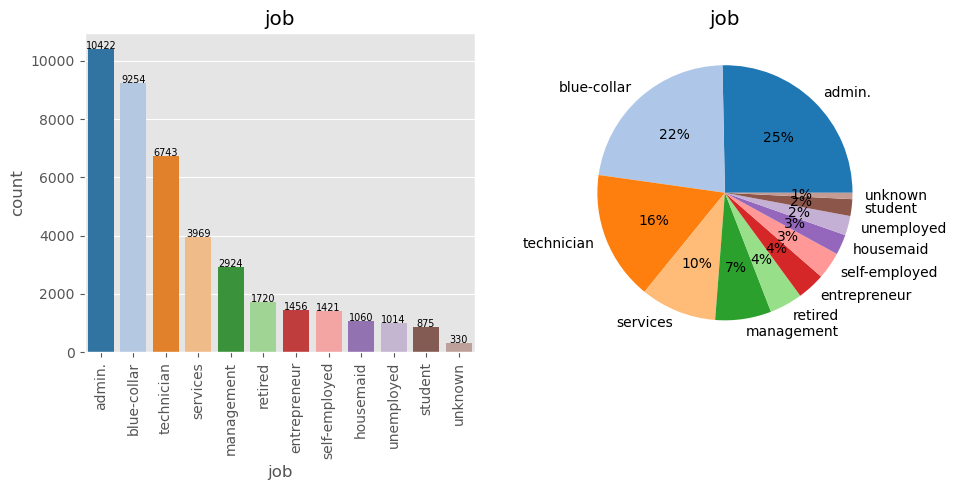

In [18]:
plt.figure(figsize=(10, 5),dpi=100)
plt.subplot(1,2,1)
variable = 'job'
ax = sns.countplot(x= variable,order =df[variable].value_counts().index, data= df, palette='tab20')
for p in ax.patches:
    height = p.get_height()
    ax.text(x = p.get_x() + p.get_width()/2, 
            y = height, 
            s = '{:.0f}'.format(height),
            ha = 'center',
            size= 7            
           )
plt.xticks(rotation= 90)
plt.title(variable)

# pie chart
plt.subplot(1,2,2)
counts = df[variable].value_counts()
plt.pie(counts, labels= counts.index, autopct='%0.0f%%', colors = sns.color_palette('tab20'))
plt.title(variable)


plt.tight_layout()
plt.show()

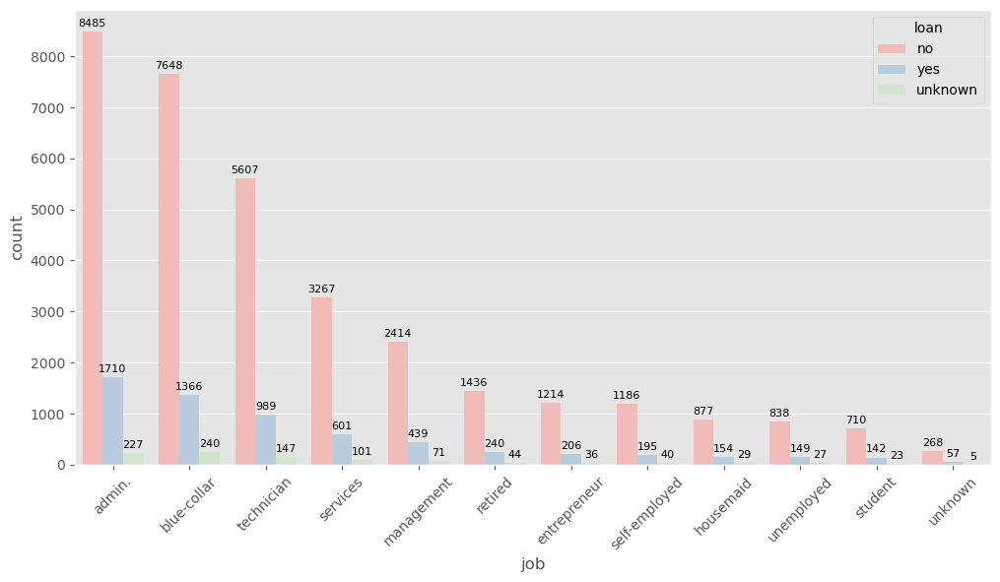

In [19]:
plt.figure(figsize=(12,6))
ax = sns.countplot(x='job', hue='loan', order = df['job'].value_counts().index ,data=df, palette='Pastel1')
for p in ax.patches:
    height = p.get_height()
    ax.text(x = p.get_x() + p.get_width()/2, 
            y = height + 100, 
            s = '{:.0f}'.format(height),
            ha = 'center',
            size= 8           
           )
plt.xticks(rotation=45)
plt.show()

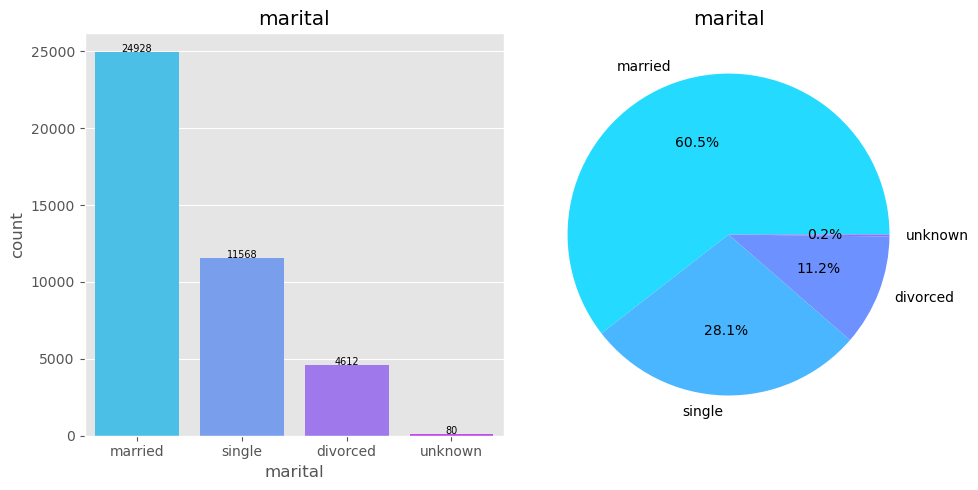

In [20]:
plt.figure(figsize=(10, 5),dpi=100)
plt.subplot(1,2,1)
variable = 'marital'
ax = sns.countplot(x= variable,order =df[variable].value_counts().index, data= df, palette='cool')
for p in ax.patches:
    height = p.get_height()
    ax.text(x = p.get_x() + p.get_width()/2, 
            y = height, 
            s = '{:.0f}'.format(height),
            ha = 'center',
            size= 7            
           )
plt.title(variable)

# pie chart
plt.subplot(1,2,2)
counts = df[variable].value_counts()
plt.pie(counts, labels= counts.index, autopct='%1.1f%%', colors= sns.color_palette('cool'))
plt.title(variable)


plt.tight_layout()
plt.show()

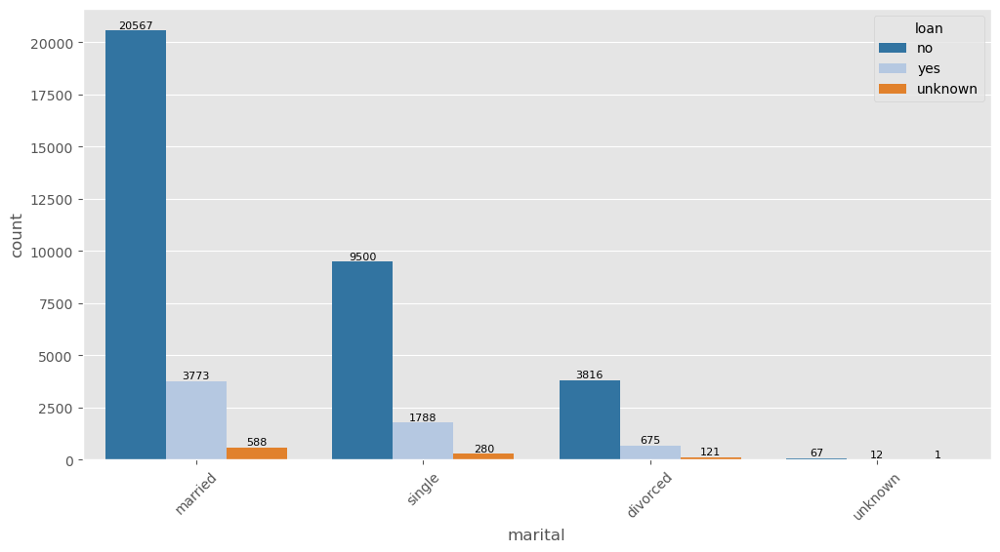

In [21]:
plt.figure(figsize=(12,6))
ax = sns.countplot(x='marital', hue='loan', order = df['marital'].value_counts().index ,data=df, palette='tab20')
for p in ax.patches:
    height = p.get_height()
    ax.text(x = p.get_x() + p.get_width()/2, 
            y = height + 100, 
            s = '{:.0f}'.format(height),
            ha = 'center',
            size= 8           
           )
plt.xticks(rotation=45)
plt.show()

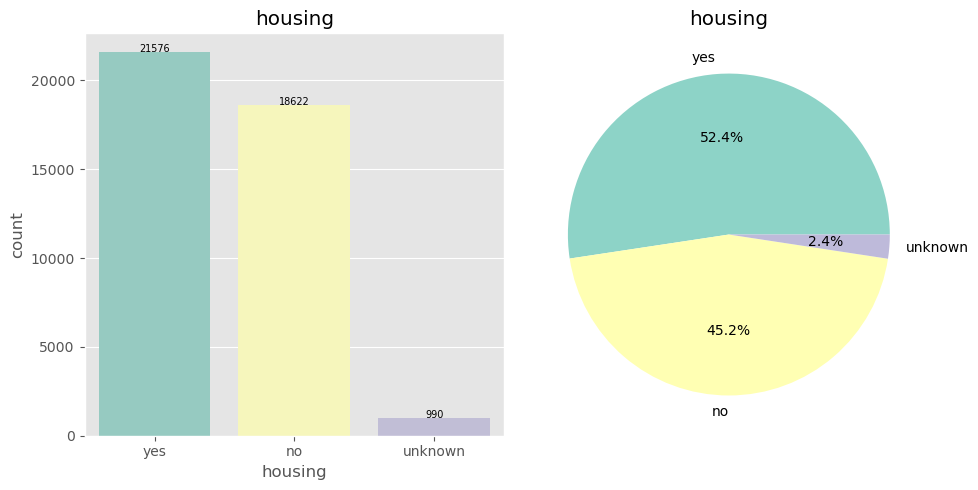

In [22]:
plt.figure(figsize=(10, 5),dpi=100)
plt.subplot(1,2,1)
variable = 'housing'
ax = sns.countplot(x= variable,order =df[variable].value_counts().index, data= df, palette='Set3')
for p in ax.patches:
    height = p.get_height()
    ax.text(x = p.get_x() + p.get_width()/2, 
            y = height, 
            s = '{:.0f}'.format(height),
            ha = 'center',
            size= 7            
           )

plt.title(variable)

# pie chart
plt.subplot(1,2,2)
counts = df[variable].value_counts()
plt.pie(counts, labels= counts.index, autopct='%0.1f%%', colors= sns.color_palette('Set3'))
plt.title(variable)


plt.tight_layout()
plt.show()

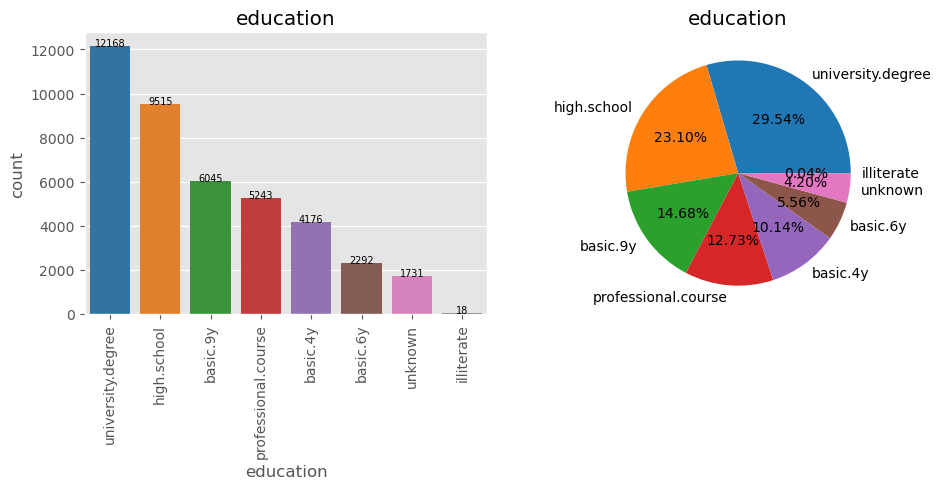

In [23]:
plt.figure(figsize=(10, 5),dpi=100)
plt.subplot(1,2,1)
variable = 'education'
ax = sns.countplot(x= variable,order =df[variable].value_counts().index, data= df, palette='tab10')
for p in ax.patches:
    height = p.get_height()
    ax.text(x = p.get_x() + p.get_width()/2, 
            y = height, 
            s = '{:.0f}'.format(height),
            ha = 'center',
            size= 7            
           )
plt.xticks(rotation=90)
plt.title(variable)

# pie chart
plt.subplot(1,2,2)
counts = df[variable].value_counts()
plt.pie(counts, labels= counts.index, autopct='%1.2f%%', colors= sns.color_palette('tab10'))
plt.title(variable)


plt.tight_layout()
plt.show()

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


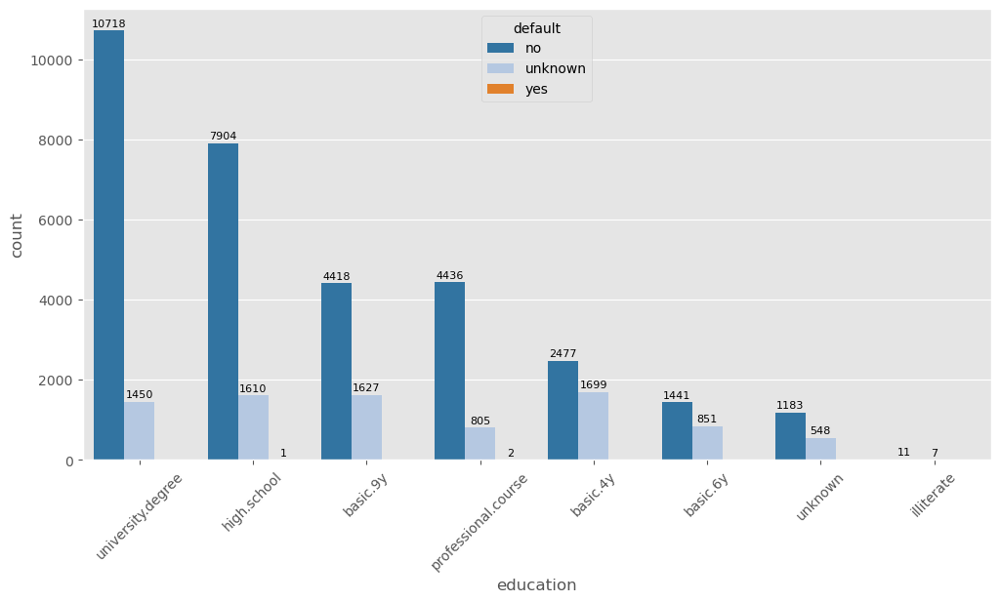

In [24]:
plt.figure(figsize=(12,6))
ax = sns.countplot(x='education', hue='default', order = df['education'].value_counts().index ,data=df, palette='tab20')
for p in ax.patches:
    height = p.get_height()
    ax.text(x = p.get_x() + p.get_width()/2, 
            y = height + 100, 
            s = '{:.0f}'.format(height),
            ha = 'center',
            size= 8           
           )
plt.xticks(rotation=45)
plt.show()

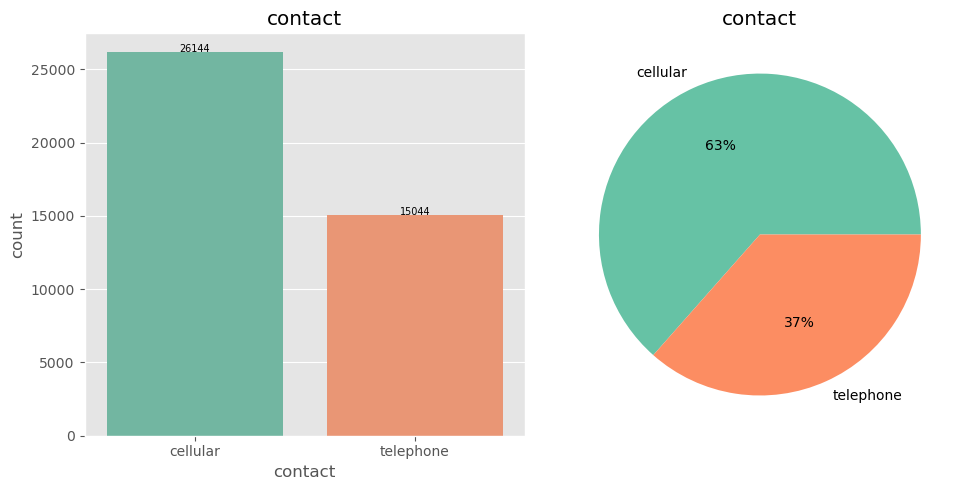

In [25]:
plt.figure(figsize=(10, 5),dpi=100)
plt.subplot(1,2,1)
variable = 'contact'
ax = sns.countplot(x= variable,order =df[variable].value_counts().index, data= df, palette='Set2')
for p in ax.patches:
    height = p.get_height()
    ax.text(x = p.get_x() + p.get_width()/2, 
            y = height, 
            s = '{:.0f}'.format(height),
            ha = 'center',
            size= 7            
           )

plt.title(variable)

# pie chart
plt.subplot(1,2,2)
counts = df[variable].value_counts()
plt.pie(counts, labels= counts.index, autopct='%0.0f%%', colors = sns.color_palette('Set2'))
plt.title(variable)


plt.tight_layout()
plt.show()

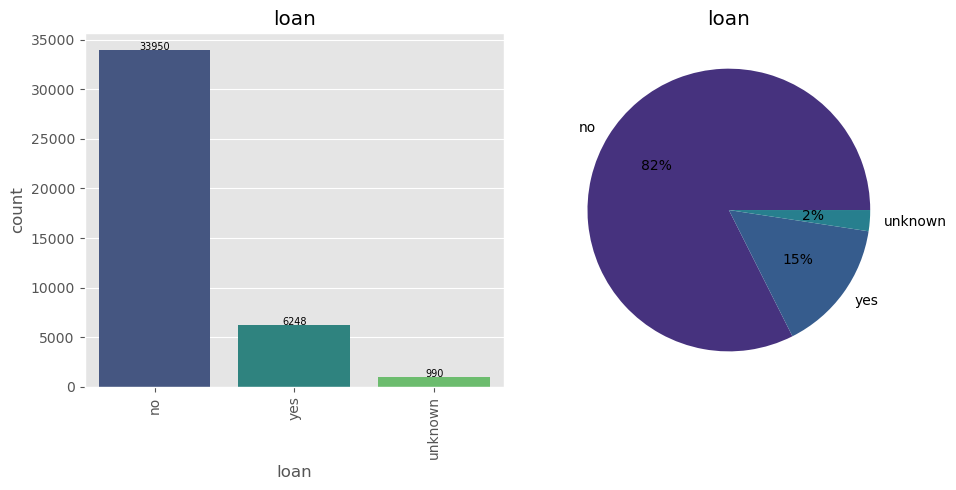

In [26]:
plt.figure(figsize=(10, 5),dpi=100)
plt.subplot(1,2,1)
variable = 'loan'
ax = sns.countplot(x= variable,order =df[variable].value_counts().index, data= df, palette='viridis')
for p in ax.patches:
    height = p.get_height()
    ax.text(x = p.get_x() + p.get_width()/2, 
            y = height, 
            s = '{:.0f}'.format(height),
            ha = 'center',
            size= 7            
           )
plt.xticks(rotation= 90)
plt.title(variable)

# pie chart
plt.subplot(1,2,2)
counts = df[variable].value_counts()
plt.pie(counts, labels= counts.index, autopct='%0.0f%%', colors = sns.color_palette('viridis'))
plt.title(variable)


plt.tight_layout()
plt.show()

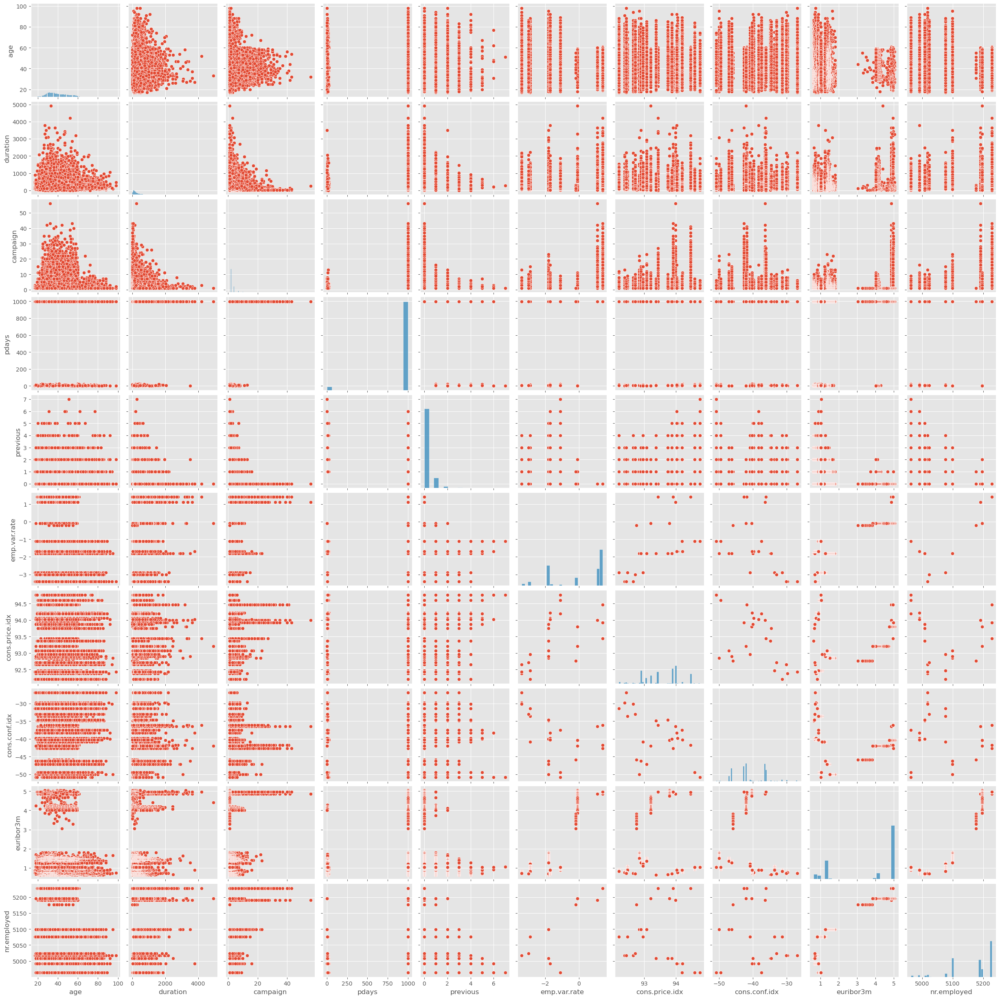

In [27]:
sns.pairplot(df);

## Feature engering

In [28]:
df.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


In [29]:
X = pd.get_dummies(df)

In [30]:
X.head()

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,...,day_of_week_fri,day_of_week_mon,day_of_week_thu,day_of_week_tue,day_of_week_wed,poutcome_failure,poutcome_nonexistent,poutcome_success,y_no,y_yes
0,56,261,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,0,1,0,0,0,0,1,0,1,0
1,57,149,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,0,1,0,0,0,0,1,0,1,0
2,37,226,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,0,1,0,0,0,0,1,0,1,0
3,40,151,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,0,1,0,0,0,0,1,0,1,0
4,56,307,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,0,1,0,0,0,0,1,0,1,0


## Scaler Data

In [31]:
from sklearn.preprocessing import StandardScaler

In [32]:
scaler = StandardScaler()

In [33]:
scaler_X = scaler.fit_transform(X)

In [34]:
scaler_X

array([[ 1.53303429,  0.01047142, -0.56592197, ..., -0.1857    ,
         0.35630932, -0.35630932],
       [ 1.62899323, -0.42150051, -0.56592197, ..., -0.1857    ,
         0.35630932, -0.35630932],
       [-0.29018564, -0.12451981, -0.56592197, ..., -0.1857    ,
         0.35630932, -0.35630932],
       ...,
       [ 1.53303429, -0.26722482, -0.20490853, ..., -0.1857    ,
         0.35630932, -0.35630932],
       [ 0.38152696,  0.70856893, -0.56592197, ..., -0.1857    ,
        -2.80655022,  2.80655022],
       [ 3.26029527, -0.07438021,  0.15610492, ..., -0.1857    ,
         0.35630932, -0.35630932]])

## Cluster KMeans

In [35]:
from sklearn.cluster import KMeans

In [36]:
model = KMeans(n_clusters=2)

In [37]:
cluster_label = model.fit(scaler_X)

In [38]:
cluster_label = cluster_label.labels_

In [39]:
cluster_label

array([0, 0, 0, ..., 1, 1, 1])

In [40]:
len(cluster_label)

41188

In [41]:
len(scaler_X)

41188

In [42]:
X['cluster'] = cluster_label

In [43]:
X.head()

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,...,day_of_week_mon,day_of_week_thu,day_of_week_tue,day_of_week_wed,poutcome_failure,poutcome_nonexistent,poutcome_success,y_no,y_yes,cluster
0,56,261,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,1,0,0,0,0,1,0,1,0,0
1,57,149,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,1,0,0,0,0,1,0,1,0,0
2,37,226,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,1,0,0,0,0,1,0,1,0,0
3,40,151,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,1,0,0,0,0,1,0,1,0,0
4,56,307,1,999,0,1.1,93.994,-36.4,4.857,5191.0,...,1,0,0,0,0,1,0,1,0,0


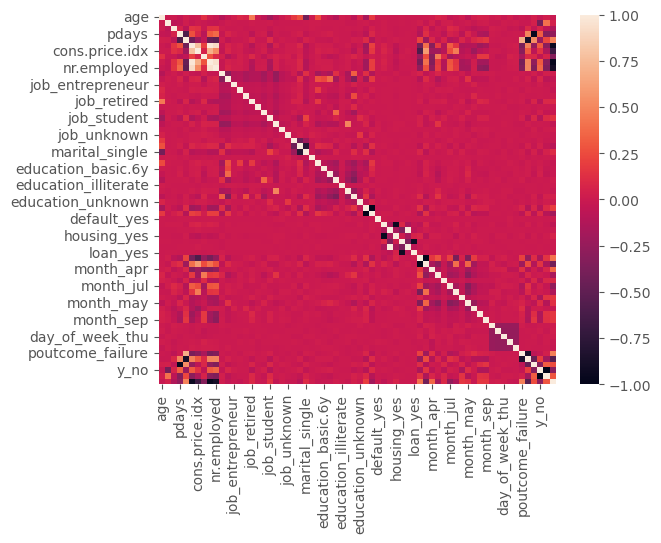

In [44]:
sns.heatmap(X.corr());

In [45]:
X.corr()['cluster']

age                    -0.019699
duration                0.039894
campaign               -0.129129
pdays                  -0.267700
previous                0.478467
                          ...   
poutcome_nonexistent   -0.544377
poutcome_success        0.254393
y_no                   -0.294610
y_yes                   0.294610
cluster                 1.000000
Name: cluster, Length: 66, dtype: float64

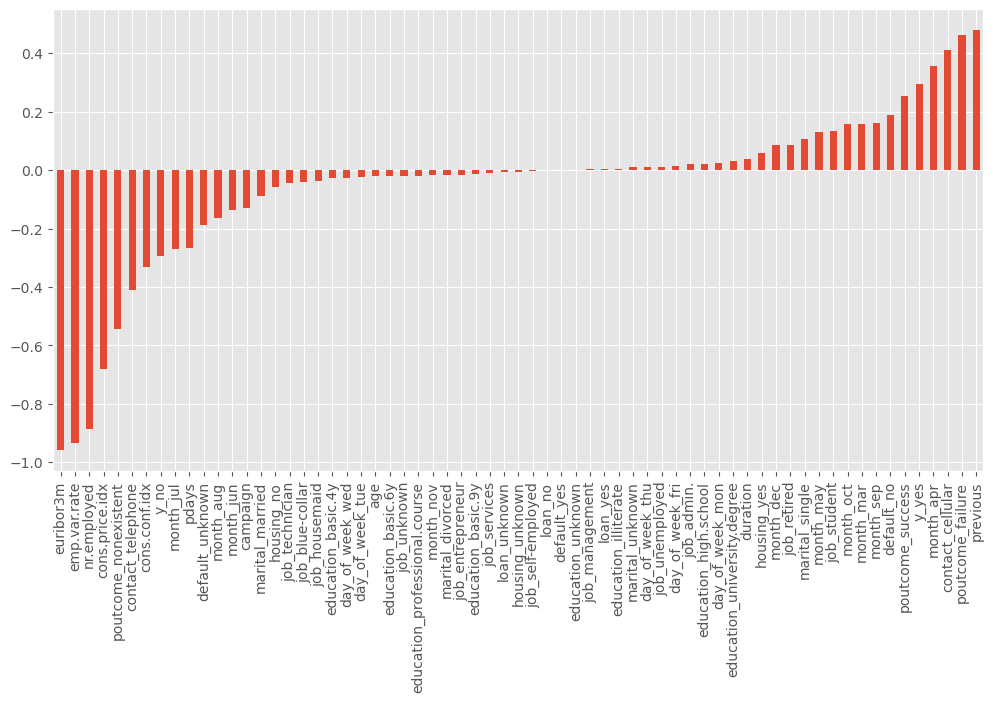

In [46]:
plt.figure(figsize=(12, 6))
X.corr()['cluster'].iloc[:-1].sort_values().plot(kind='bar');

### Method elbow / Choose k value
* Mencari jumlah optimal dari cluster (k) dengan menggunakan metode ***Elbow Curve***.

* ***Elbow Curve***, merupakan salah satu metode yang bisa digunakan untuk menemukan jumlah optimal dari cluster (k)

In [47]:
ssd = []
for k in range(2, 10):
    model = KMeans(n_clusters= k)
    model.fit(scaler_X)
    
    # ssd
    ssd.append(model.inertia_)

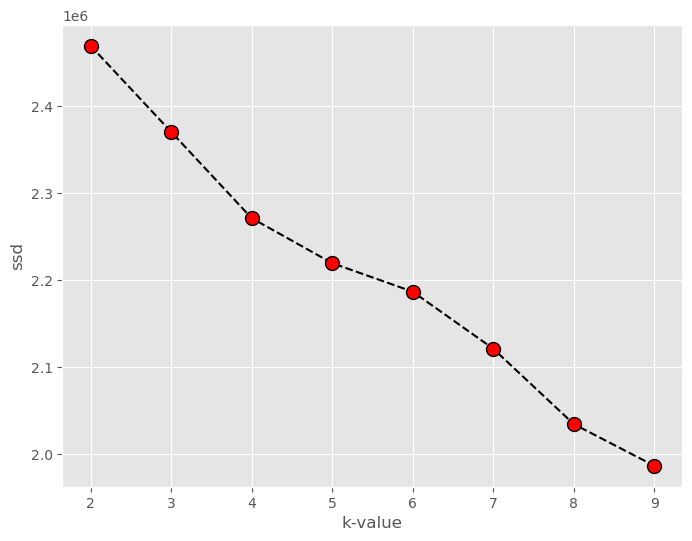

In [48]:
plt.figure(figsize=(8,6), dpi=100)
plt.plot(range(2,10), ssd, 'o--',color='k', markerfacecolor='red', markersize=10)
plt.xlabel('k-value')
plt.ylabel('ssd');

In [49]:
ssd

[2469792.3673020783,
 2370787.1791007067,
 2271503.8604776994,
 2219763.587964679,
 2186949.7520539565,
 2121405.328110991,
 2034675.7629700326,
 1986760.813853898]

In [50]:
# Change in SSD from previous K value!
pd.Series(ssd).diff()

0             NaN
1   -99005.188201
2   -99283.318623
3   -51740.272513
4   -32813.835911
5   -65544.423943
6   -86729.565141
7   -47914.949116
dtype: float64

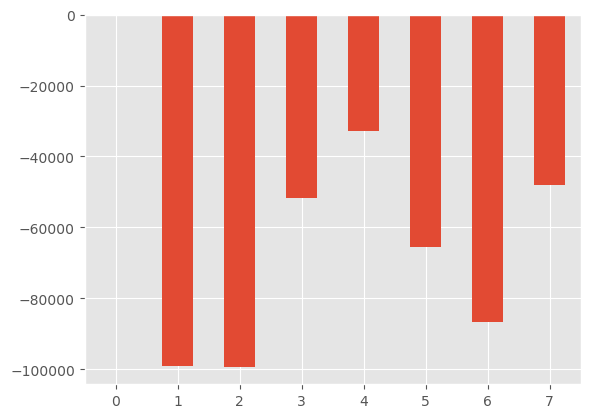

In [51]:
pd.Series(ssd).diff().plot(kind='bar')
plt.xticks(rotation= 0);

### Silhouette score
* Pada **elbow curve method**, lokasi ‘***tikungan***’ yang terbentuk di plot, pada umumnya dianggap sebagai indikator jumlah cluster yang tepat
* Akan tetapi nilai k ***optimal*** yang diperoleh dari metode elbow curve, sering kali bersifat ***ambigu*** atau belum pasti akan menghasilkan jumlah cluster (k) yang optimal

In [52]:
from sklearn.metrics import silhouette_score

In [53]:
for k in range(2, 10):
    model = KMeans(n_clusters = k)
    cluster = model.fit(scaler_X)
    cluster_label = cluster.labels_
    
    # silhouette avg
    silhouette_avg = silhouette_score(scaler_X, cluster_label)
    # print result
    print(f'n_cluster ={k}, nilai silhouette score ={silhouette_avg}')

n_cluster =2, nilai silhouette score =0.11700113001983012
n_cluster =3, nilai silhouette score =0.11158060627054224
n_cluster =4, nilai silhouette score =0.05865324295346011
n_cluster =5, nilai silhouette score =0.06753115334689078
n_cluster =6, nilai silhouette score =0.06928439390841888
n_cluster =7, nilai silhouette score =0.07344861545558898
n_cluster =8, nilai silhouette score =0.07558539480656219
n_cluster =9, nilai silhouette score =0.06323863260130996


In [54]:
kmeans_for_k = [KMeans(n_clusters= k).fit(scaler_X) for k in range(2, 10)]

silhouette_score = [silhouette_score(scaler_X, model.labels_)
                   for model in kmeans_for_k[:1]]

In [55]:
silhouette_score

[0.11700051193065535]

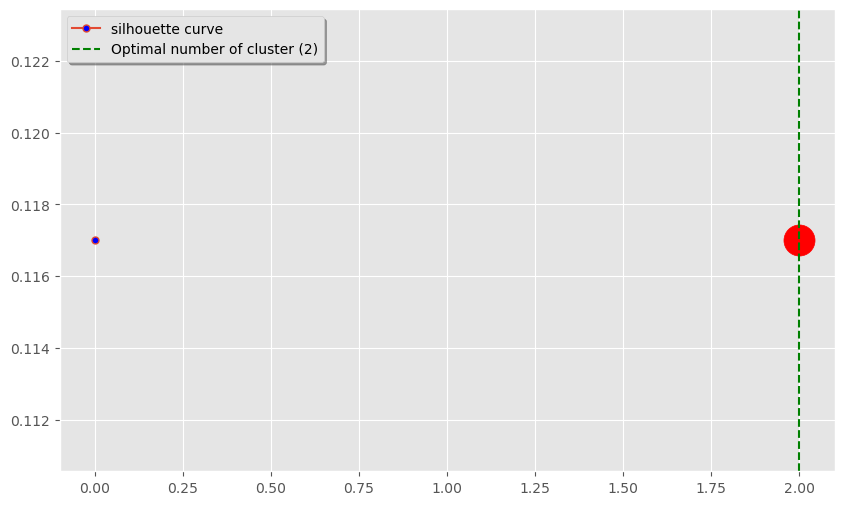

In [56]:
plt.figure(figsize=(10, 6))
plt.plot(silhouette_score, 'o-',markersize= 5,markerfacecolor='blue', label = 'silhouette curve')

k = np.argmax(silhouette_score)+2

plt.axvline(k, ls='--',color='green', label ='Optimal number of cluster ({})'.format(k))
plt.scatter(k, silhouette_score[k-2], color='red',s=500 )
plt.legend(shadow=True)
plt.show()

* Hasil dari perhitungan **shilouette score** nilai tertinggi pada cluster (k-2)

## Final Model

In [57]:
k2 = KMeans(n_clusters = 2)

In [58]:
cls = k2.fit(scaler_X)

In [59]:
cls_label = cls.labels_

In [60]:
cls_label

array([1, 1, 1, ..., 0, 0, 0])

In [61]:
df['cluster'] = cls_label

In [62]:
df.corr()['cluster'].sort_values()

previous         -0.478493
duration         -0.039581
age               0.019767
campaign          0.129103
pdays             0.267714
cons.conf.idx     0.330916
cons.price.idx    0.679350
nr.employed       0.886190
emp.var.rate      0.932622
euribor3m         0.959328
cluster           1.000000
Name: cluster, dtype: float64

In [63]:
df.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,cluster
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,1
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,1
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,1
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,1
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,1


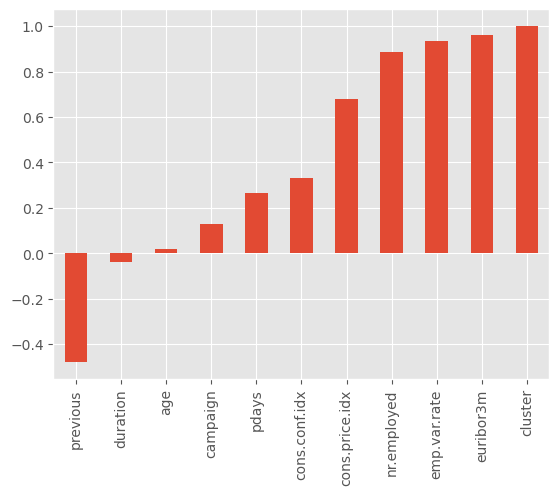

In [64]:
df.corr()['cluster'].sort_values().plot(kind='bar');

In [65]:
df.columns

Index(['age', 'job', 'marital', 'education', 'default', 'housing', 'loan',
       'contact', 'month', 'day_of_week', 'duration', 'campaign', 'pdays',
       'previous', 'poutcome', 'emp.var.rate', 'cons.price.idx',
       'cons.conf.idx', 'euribor3m', 'nr.employed', 'y', 'cluster'],
      dtype='object')

In [66]:
import plotly.express as px

In [67]:
fig = px.scatter_3d(df, x=df['age'], y=df['campaign'], z=df['cluster'], 
                    color = df['cluster'], height = 500, width = 700, 
                    hover_data = ['job', 'marital', 'education', 'default', 'housing', 'loan',
                                  'contact', 'month', 'day_of_week', 'duration','pdays','previous', 
                                  'poutcome', 'emp.var.rate', 'cons.price.idx','cons.conf.idx',
                                  'euribor3m', 'nr.employed', 'y'])
fig.update_traces(marker=dict(size= 7, 
                             line=dict(width = 3, color='#373A40')), 
                 selector= dict(mode='markers')                 
                )
fig.show()